# <center> Totalsat Package Demo </center>


Thomas de Mareuil - June 2020

This notebook presents how to use the `totalsat` package. For more details, do not hesitate to take a look at the code or documentation (automatically generated - code is better).

<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Download-and-process-public-satellite-imagery-with-Python" data-toc-modified-id="Download-and-process-public-satellite-imagery-with-Python-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Download and process public satellite imagery with Python</a></span><ul class="toc-item"><li><span><a href="#Search-for-images" data-toc-modified-id="Search-for-images-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Search for images</a></span></li><li><span><a href="#Download-images" data-toc-modified-id="Download-images-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Download images</a></span></li><li><span><a href="#Preprocess-images" data-toc-modified-id="Preprocess-images-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Preprocess images</a></span></li></ul></li><li><span><a href="#Other-totalsat-tools-and-features" data-toc-modified-id="Other-totalsat-tools-and-features-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Other <code>totalsat</code> tools and features</a></span><ul class="toc-item"><li><span><a href="#Split-images" data-toc-modified-id="Split-images-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Split images</a></span></li><li><span><a href="#Label-images" data-toc-modified-id="Label-images-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Label images</a></span></li><li><span><a href="#Create-timelapse-video" data-toc-modified-id="Create-timelapse-video-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Create timelapse video</a></span></li><li><span><a href="#Create-gif" data-toc-modified-id="Create-gif-2.4"><span class="toc-item-num">2.4&nbsp;&nbsp;</span>Create gif</a></span></li><li><span><a href="#Reverse-geocoding" data-toc-modified-id="Reverse-geocoding-2.5"><span class="toc-item-num">2.5&nbsp;&nbsp;</span>Reverse geocoding</a></span></li><li><span><a href="#Download-OSM-data" data-toc-modified-id="Download-OSM-data-2.6"><span class="toc-item-num">2.6&nbsp;&nbsp;</span>Download OSM data</a></span></li></ul></li></ul></div>

In [2]:
# notebook imports
import os
import sys
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
import rasterio
from rasterio import plot
import shapely
import warnings
from IPython.display import Image, Video
import matplotlib.image
import pandas as pd
import folium
from folium import IFrame
from folium.plugins import MarkerCluster
from shapely.geometry import Polygon, Point
import pickle
warnings.filterwarnings("ignore")

# totalsat imports
sys.path.insert(0, '../..') # move to parent directory twice
from totalsat import sat_download, sat_preprocess, sat_tools

## Download and process public satellite imagery with Python

The `totalsat` library contains (for now) 3 modules: `sat_download`, `sat_preprocess` and `sat_tools` (utils module). We present in this notebook several **examples and use cases**.

### Search for images

`totalsat` connects to Google Earth Engine to browse through public image collections. For now, you can access images provided by Landsat 5, 7 and 8 (Tier 1 and Tier 2 quality) and by Sentinel-2 (Level 1-C TOA and Level 2-A BOA). You can check image availability based on a list of criteria, passed as a Python dictionary.

Criteria can include:
* coordinates of the region to download (either a polygon or a point + radius in km, max: 50)
* date range (by default, the last week) - you can also use key words such as 'last' or 'today'
* chosen satellites (among Sentinel-2, Sentinel-2 direct RGB and Landsat 5-7-8)
* max cloud cover percentage (by default, 10%)
* max image size, in pixels (which allows to split the original area of interest into smaller tiles)

Several other options are available, make sure you read the documentation or directly the code function for details.

In [3]:
inputs = {'sat_list': ['S2', 'L8'],
          'dates': ['2020-06-21','2020-07-01'],
          'point': [-0.983083, 44.288250],
          'radius': 5,
          'max_cloud_cover': 5,
          'filepath': '../../trees/data',
          'sitename': 'demeter_demo',
          'max_size': 256,
          'include_T2': False,
          'merge': True
         }

In [4]:
im_dict_T1, im_dict_T2 = sat_download.check_images_available(inputs);

Your area of interest will be split into smaller image areas to fit max_size requirements.

Searching for images on the GEE server...

- In Landsat Tier 1 & Sentinel-2 Level-1C / Level 2-A:
  S2: 16 image(s)
  L8: 0 image(s)
  Total: 16 image(s) selected.


With another function, we can plot the requested area on an interactive `folium` map. The layer control toggle allows to switch from map to satellite view and to visualize the area split.

In [30]:
sat_download.plot_requested_area(inputs)

### Download images

The satellite images come with several spectral bands (13 for Sentinel-2, 9 for Landsat), in resolutions from 10m to 60m per pixel, as described below:
<br>
<img src="https://www.researchgate.net/profile/Lauri_Korhonen/publication/316644351/figure/tbl1/AS:753655984701441@1556696997414/Spectral-bands-and-resolutions-of-Landsat-8-OLI-and-Sentinel-2-MSI-sensors-70.png" alt="bands" width="600"/>
<br>

You can use the `retrieve_images()` function to download images under the defined area of interest and save them as georeferenced .tif files (+ metadata in .txt files, in a separate folder). 1 folder will be created per satellite, under a specified project name (`sitename`) and path (`filepath`). The output of the function in the notebook is a dictionary containing the metadata of each downloaded image.

If you specify `merge=True`, the function also automatically removes potential image duplicates and merges overlapping images (if your area of interest is under 2 different satellite passes). Careful not to set this option when you limit image size, i.e. when you split a large satellite image into several smaller tiles - as tiles are taken from the same image, they could be merged together...

In [6]:
metadata = sat_download.retrieve_images(inputs, im_dict_T1=im_dict_T1)



S2: 16 image(s)
100%
L8: 0 image(s)


If you have already downloaded the images earlier, you can just reload the metadata files by running the `sat_download.get_metadata(inputs)` function, and you can move on to preprocessing.

In [11]:
metadata = sat_download.get_metadata(inputs)
# print(metadata)

### Preprocess images

Each downloaded image contains several unprocessed spectral bands stacked on top of each other. The `sat_preprocess` module allows you to create an RGB image or other remote sensing indices (NDVI, BSI, etc. - 7 pre-coded indices available), as well as a custom combination of spectral bands. 

The RGB preprocessing mainly consists in stretching the pixel values so that they cover the entire value range. The other indices are just about computing different band combinations. These methods are meant to be a quick hack, without histogram correction techniques or additional steps that would be required for a perfectly clean output.

Note: to avoid the RGB processing, you can directly download RGB images from the 'S2_RGB' satellite (Sentinel-2 Level-2A BOA reflectance), but these images tend to have more errors than 'S2' (Sentinel-2 Level-1C TOA reflectance) - more areas with black pixels, etc.

The preprocessed images are then saved in a separate folder as georeferenced TIF files (metadata is maintained). If you specify a 1-channel remote sensing index (ex: NDVI), it also saves a JPG file with a chosen `colormap` for visualization (default: matplotlib's "summer" palette).

In [15]:
sat_preprocess.save_files(metadata, inputs, formula='[ RGB ]') # spaces in the formula are important for parsing

Starting preprocessing as RGB...
100%
RGB satellite images saved in ../../trees/data/demeter_demo/preprocessed_files/RGB


We can check that the metadata from the newly written images was maintained (with `rasterio`), and display one of the images:

In [23]:
example = '../../trees/data/demeter_demo/preprocessed_files/RGB/2020-06-22-11-08-53_S2_demeter_demo_10m_14-41-51_S2_RGB.tif'
with rasterio.open(example) as src:
    meta = src.meta
    image = src.read()
meta

{'driver': 'GTiff',
 'dtype': 'uint8',
 'nodata': None,
 'width': 258,
 'height': 258,
 'count': 3,
 'crs': CRS.from_epsg(32630),
 'transform': Affine(10.0, 0.0, 660800.0,
        0.0, -10.0, 4910910.0)}

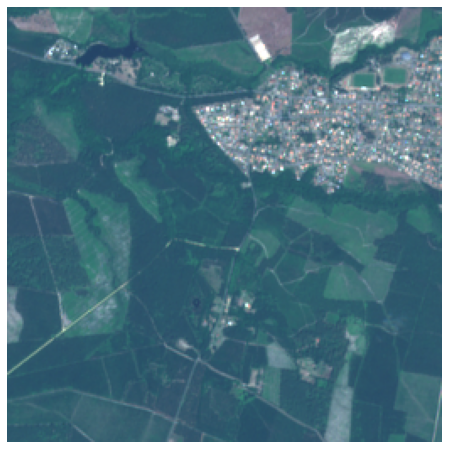

In [25]:
plt.figure(figsize = (8,8))
plt.axis('off')
plt.imshow(rasterio.plot.reshape_as_image(image))
plt.show()

We can also compute the NDVI (Normalized Difference Vegetation Index, showing vegetation health) and NDWI (Normalized Difference Water Index, showing image water content), using different colormaps for visualizations (see list of possible colormaps [here](https://matplotlib.org/examples/color/colormaps_reference.html)).

In [26]:
sat_preprocess.save_files(metadata, inputs, formula='[ NDVI ]')

Starting preprocessing as NDVI...
100%
NDVI satellite images saved in ../../trees/data/demeter_demo/preprocessed_files/NDVI


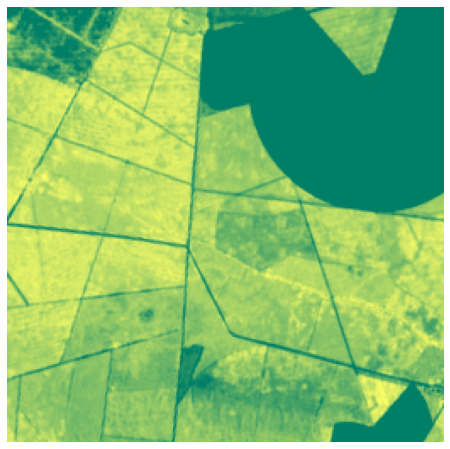

In [28]:
img = plt.imread('../../trees/data/demeter_demo/preprocessed_files/NDVI/2020-06-22-11-08-53_S2_demeter_demo_10m_14-40-59_S2_NDVI.png')
plt.figure(figsize = (8,8))
plt.axis('off')
plt.imshow(img)
plt.show()

In [29]:
sat_preprocess.save_files(metadata, inputs, formula='[ NDWI ]', colormap='winter')

Starting preprocessing as NDWI...
100%
NDWI satellite images saved in ../../trees/data/demeter_demo/preprocessed_files/NDWI


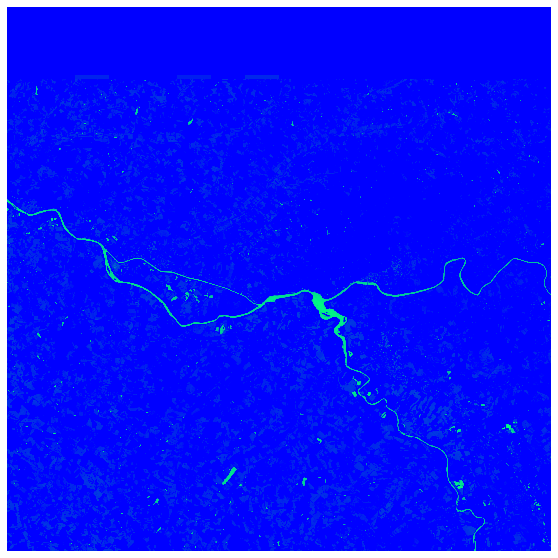

In [32]:
img = plt.imread('../data/Test/preprocessed_files/NDWI/2020-05-25-10-58-59_S2.png')
plt.figure(figsize = (10,10))
plt.axis('off')
plt.imshow(img)
plt.show()

Last, but not least, we can compute any band combination using a custom formula. 

Valid combinations are of the form: [ R * 0.5 , NIR * 1 , B * 0.7 ]. Make sure you add spaces everywhere for the parser to understand the formula. Coefficients correspond to pixel intensity (in %). The first band will be interpreted as Red channel, the 2nd one as Green channel, and the 3rd one as Blue channel. This way, we can experiment, use false colors, adjust color intensity, etc... let's get creative!

You can see more details and examples of "custom scripts" through this [link](sentinel-hub.com/sites/default/Custom_script_tutorial.pdf).

In [36]:
sat_preprocess.save_files(metadata, inputs, formula='[ R * 1 , NIR * 0.5 , B * 0.7 ]')

Starting preprocessing as R*1,NIR*0.5,B*0.7...
100%
R*1,NIR*0.5,B*0.7 satellite images saved in ../../trees/data/demeter_demo/preprocessed_files/custom_formula


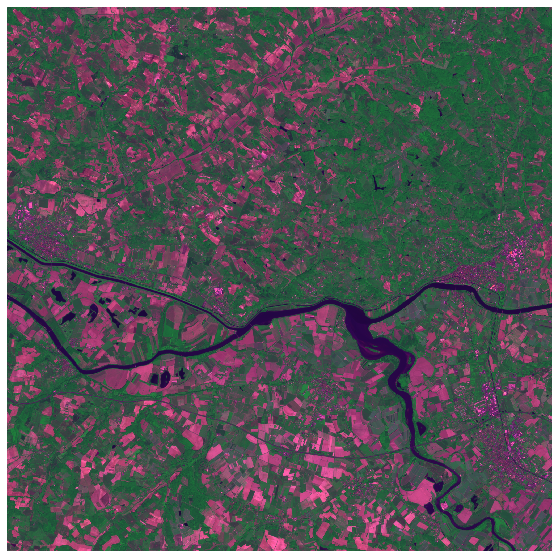

In [8]:
img = plt.imread('../../trees/data/demeter_demo/preprocessed_files/RGB_2/2020-05-30-10-58-50_S2_Demo_10m_22-15-56_S2_R*1,NIR*0.5,B*0.7.tif')
plt.figure(figsize = (10,10))
plt.axis('off')
plt.imshow(img)
plt.show()

## Other `totalsat` tools and features

Tthe `totalsat` package also provides several utilities in the `sat_tools` module and additional features, as presented below.

### Split images

The `split_image` function from `sat_tools` can be used to split any image in smaller tiles (remark: tiles are saved as PNG, which doesn't maintain metadata).

The number of tiles depends either on a specific `nb_tiles` argument or on a `max_tile_size` argument. Tiles follow by default the image aspect ratio, but can be set to square shape with the `square` argument. They are automatically numbered and saved either in a chosen `filepath_out` or in the folders defined by the `inputs` dict (from previous steps). The `show` argument allows to display a preview of the split.

Splitting the original image in 16 tiles of size 512x512...
Tiles successfully saved in ../../trees/data/demeter_demo/preprocessed_files/split_tiles.


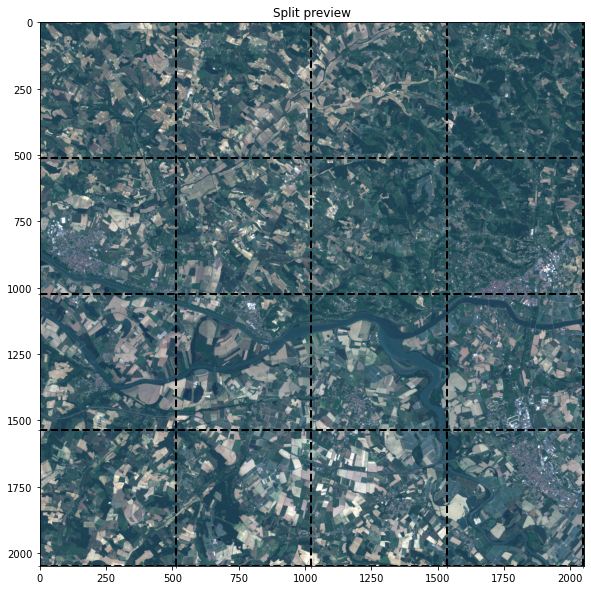

In [37]:
sat_tools.split_image(image_path='../../trees/data/demeter_demo/preprocessed_files/RGB_2/2020-05-25-10-58-45_S2_Demo_10m_22-15-33_S2_RGB.tif',
                      square=True, max_tile_size=512*512,
                      inputs=inputs, show=True)

We can finally just check one of the small tiles:

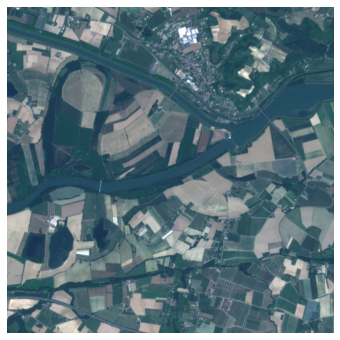

In [38]:
img = plt.imread('../../trees/data/demeter_demo/preprocessed_files/split_tiles/2020-05-25-10-58-45_S2_Demo_10m_22-15-33_S2_RGB_03_02.png')
plt.figure(figsize = (6,6))
plt.axis('off')
plt.imshow(img)
plt.show()

### Label images

Finally, the `annotate_images` function from the `sat_tools` module, associated with `%matplotlib qt` linemagic command, allows us to directly label images (either **polygon annotations** for segmentation or **boolean labels** for classification) in a notebook through an interactive matplotlib console. The labels can then be used to train object detection or object segmentation (binary masks) models.

You can pass to the function either the inputs dictionary from previous steps, or the path to a folder with georeferenced images to label.

The polygon annotations will be saved in the same folder as the images, in .geojson and .pkl formats (both in pixel coordinates and in epsg:4326). Boolean annotations are saved as .csv.

In [7]:
%matplotlib qt

labels = sat_tools.annotate_images(source='../../other/presentations/demeter_update_demo/preprocessed_files/labels_demo', 
                                   label_type='polygon')

Polygon annotations have been saved in ../../other/presentations/demeter_update_demo/preprocessed_files/labels_demo.


In [8]:
labels

[array([[-0.99620874, 44.27971349,  0.        ],
        [-0.99119409, 44.28007863,  0.        ],
        [-0.99084941, 44.27829193,  0.        ],
        [-0.98704118, 44.2776421 ,  0.        ],
        [-0.98767772, 44.27483667,  0.        ],
        [-0.99490412, 44.27434867,  0.        ]])]

Finally, you can use the `plot_geometries` function to check the polygon labels on an interactive satellite map. You can pass to the function either the list of polygon coordinates outputted by `annotate_images`, or a list of polygon coordinates (`(lon,lat)` format) extracted from a .geojson file, or a geodataframe with a 'geometry' column.

In [9]:
sat_tools.plot_geometries(labels)

And boolean annotations:

In [5]:
%matplotlib qt

labels = sat_tools.annotate_images(source='../../trees/data/demeter_demo/preprocessed_files/labels_demo', 
                                   label_type='binary')

Annotations already exist and have been loaded.


In [6]:
labels

,image_name,label
0,2020-06-22-11-08-53_S2_demeter_demo_10m_14-41-...,False
1,2020-06-22-11-08-53_S2_demeter_demo_10m_14-41-...,True
2,2020-06-22-11-08-53_S2_demeter_demo_10m_14-41-...,False


### Create timelapse video

The `sat_preprocess.timelapse()` function takes as argument a list of settings and saves a .mp4 in the Google Drive linked to the user's GEE account. Available images are Landsat 5 (03/1984 - 05/2013), Landsat 7 (04/1999 - present), and Landsat 8 (06/2013 - present).

Possible improvements include: 1) download video directly on disk, 2) add Sentinel-2 and MODIS, 3) add remote sensing indices timelapse, 4) merge sources if dates spans over several satellite periods, 5) add dates as text overlay. To create better timelapses with almost all these options, you can refer to the awesome [`geemap`](https://github.com/giswqs/geemap) package.

In [5]:
timelapse_settings = {'sat': 'L5',
                      'dates': ['1990-05-25', '1995-06-02'],
                      'point': [-122.3286, 37.6325],
                      'radius': 30,
                      #'bbox': bbox,
                      'max_cloud_cover': 20,
                      'bands': ['R', 'SWIR1', 'B'],
                      'filename': 'timelapse_demo',
                      'frames_per_sec': 8,
                      'video_dim': 720
                      }

In [6]:
sat_preprocess.timelapse(timelapse_settings, correct_path_row=False);

Processing timelapse on GEE server...
READY
RUNNING
RUNNING
RUNNING
RUNNING
COMPLETED - Please check on your Google Drive account.


In [19]:
# play video in notebook
Video("../../other/presentations/timelapse_demo.mp4", width=500, height=500)

### Create gif

The `sat_tools.create_gif()` function takes as arguments an input folder with images, the image extension name and an output path to save a GIF file. Default duration is 200ms/image, but it can be adjusted with the `duration` argument.

In [10]:
sat_tools.create_gif(input_folder='../../trees/models/small_gan/gifs/reconstruct',
                     extension='.jpg',
                     output_path='../../trees/models/small_gan/gifs/reconstruct/reconstruct.gif')

GIF saved at ../../trees/models/small_gan/gifs/reconstruct/reconstruct.gif


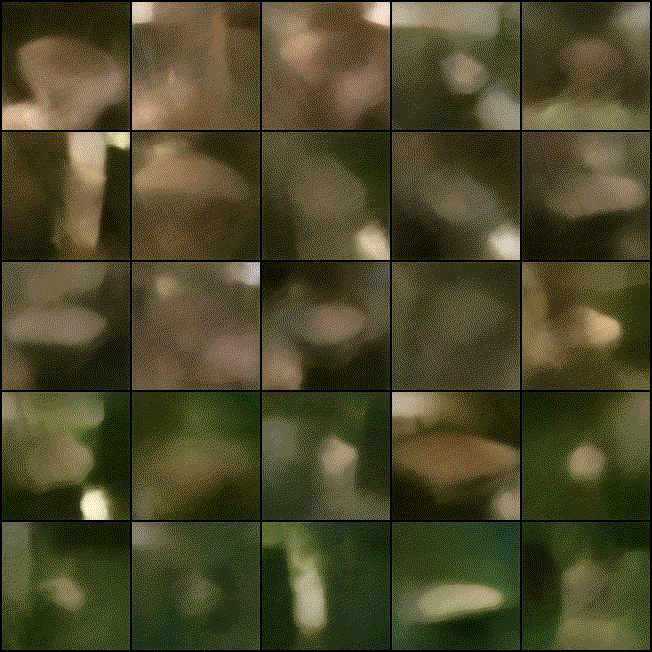

In [18]:
Image(filename='../../trees/models/small_gan/gifs/reconstruct/reconstruct.gif', 
      format='png', width=500, height=500)

### Reverse geocoding

We can use some last `totalsat` functions to perform reverse geocoding on a set of images. With `sat_tools.get_image_centroid`, we can get the coordinates of the center of a georeferenced image, and with `sat_tools.get_address` we can then retrieve the corresponding address.

The available address information depends on OSM through the Nominatim API (missing data is replaced with a NaN), and the user can specify a custom address parsing (among: 'full_address_df', 'full_address_str' and one or several keys among `['country', 'state', 'county', 'postcode', city', 'road', 'house_number']`).

We test these functions on the images downloaded earlier in this notebook:

In [28]:
images = glob.glob('../../trees/data/demeter_demo/preprocessed_files/RGB/*.tif')

for i, image in enumerate(images):
    coords = sat_tools.get_image_centroid(image)
    if i == 0: # init dataframe at first loop
        address_df = sat_tools.get_address(coords, parsing=['road','postcode','city','county','state'])
    else:
        new_df = sat_tools.get_address(coords, parsing=['road','postcode','city','county','state'])
        address_df = pd.concat([address_df, new_df], axis=0, join='outer')

address_df.reset_index(inplace = True, drop = True)
address_df

,road,postcode,city,county,state,lat,lon
0,Route du Pierron,40160,Parentis-en-Born,Landes,Nouvelle-Aquitaine,44.321735,-1.030223
1,NaN,40210,Lüe,Landes,Nouvelle-Aquitaine,44.254280,-0.967278
2,Route de Lüe,40160,Parentis-en-Born,Landes,Nouvelle-Aquitaine,44.299227,-1.030224
3,Route de Cabeil,40160,Ychoux,Landes,Nouvelle-Aquitaine,44.321756,-0.967268
4,NaN,40160,Ychoux,Landes,Nouvelle-Aquitaine,44.321776,-0.935728
5,NaN,40210,Lüe,Landes,Nouvelle-Aquitaine,44.276787,-0.967254
6,NaN,40160,Parentis-en-Born,Landes,Nouvelle-Aquitaine,44.299220,-0.998759
7,NaN,40210,Lüe,Landes,Nouvelle-Aquitaine,44.254254,-0.935712
8,Route des Grands Lacs,40210,Lüe,Landes,Nouvelle-Aquitaine,44.276713,-0.998772
9,NaN,40210,Lüe,Landes,Nouvelle-Aquitaine,44.276762,-0.935739


### Download OSM data

The last feature we present in this notebook is a high-level function to download OSM data. This feature is based on the `osmnx` package, and is just meant to simplify its usage with a high-level command - you just have to specify an OSM tag key (ex: 'building') and an area (either a point and radius, or an address and radius, or a polygon, or a place name), and the function returns a geodataframe containing the geometries.

For more complex OSM queries, you can use the online Overpass API ([link](https://overpass-turbo.eu)) or direct URL requests.

Example with building polygons:

In [11]:
footprints = sat_download.download_footprints('building',
                                              point=(43.556464, 1.299856), 
                                              radius=1000)
print(f'{len(footprints)} building polygons found in a 1km area around the {(43.556464, 1.299856)} point.')
footprints.head(3)

5169 building polygons found in a 1km area around the (43.556464, 1.299856) point.


,nodes,building,source,geometry,wall,operator,power,substation,voltage,name,...,religion,source:heritage,wikidata,addr:city,addr:housenumber,addr:postcode,addr:street,office,members,type
74183109,"[877450495, 877453954, 877415520, 877276703, 8...",yes,cadastre-dgi-fr source : Direction Générale de...,"POLYGON ((1.29284 43.56465, 1.29289 43.56457, ...",NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
74183113,"[877276794, 877396151, 877394834, 877290065, 8...",yes,cadastre-dgi-fr source : Direction Générale de...,"POLYGON ((1.29291 43.56543, 1.29295 43.56538, ...",NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
74183127,"[877450357, 877293567, 877310611, 877338519, 8...",yes,cadastre-dgi-fr source : Direction Générale de...,"POLYGON ((1.30904 43.55527, 1.30902 43.55524, ...",NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
sat_tools.plot_geometries(footprints)

Example with road linestrings:

In [12]:
# output as geodataframe, with roads as linestrings

footprints = sat_download.download_footprints("roads", 
                                              point=(43.556464299999895, 1.2998568999825626), 
                                              radius=1000,
                                             )
print(f'{len(footprints)} road linestrings found in a 500m area around the {(43.556464, 1.299856)} point.')
footprints.head(3)

1650 road linestrings found in a 500m area around the (43.556464, 1.299856) point.


,osmid,name,highway,maxspeed,oneway,length,geometry,lanes,ref,service,junction,access,bridge,tunnel,u,v,key
0,153833859,Rue du Docteur Armaing,secondary,50,False,4.006,"LINESTRING (1.29556 43.56296, 1.29553 43.56299)",NaN,NaN,NaN,NaN,NaN,NaN,NaN,2301077514,246453194,0
1,153833859,Rue du Docteur Armaing,secondary,50,False,146.343,"LINESTRING (1.29556 43.56296, 1.29650 43.56184)",NaN,NaN,NaN,NaN,NaN,NaN,NaN,2301077514,1613486981,0
2,221054103,NaN,footway,NaN,False,152.841,"LINESTRING (1.29556 43.56296, 1.29550 43.56294...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,2301077514,2301077500,0


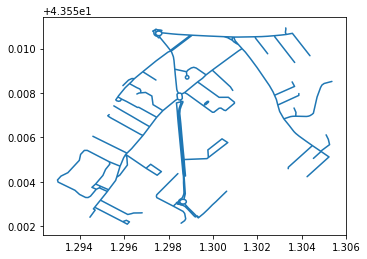

In [8]:
# output as multipolygon object, with roads as buffered linestrings (i.e. polygons)

footprints = sat_download.download_footprints("roads", 
                                              point=(43.556464299999895, 1.2998568999825626), 
                                              radius=500,
                                              buff = 5)
footprints = gpd.GeoSeries(footprints)
footprints.plot();